#1. Cài thư viện

In [31]:
!pip install -q --upgrade --force-reinstall \
  numpy==1.26.4 \
  torch==2.2.2 \
  torchvision==0.17.2 \
  torchaudio==2.2.2 \
  facenet-pytorch==2.6.0 \
  pillow==10.2.0 \
  pandas kaggle ffmpeg-python librosa==0.10.1 scikit-learn matplotlib tqdm \
  opencv-python==4.8.1.78


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.2/91.2 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.3/112.3 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 126.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 795.2 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 88.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 94.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 67.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 109.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.7/253.7 kB 24.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7

# **Mount & tạo thư mục dự án**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

# Cell 0: Config & Labels
import os, random, numpy as np, torch

PROJECT_DIR = "/content/drive/MyDrive/av_emotion"
DATA_DIR    = f"{PROJECT_DIR}/data/cremad"
SPLIT_DIR   = f"{PROJECT_DIR}/splits"
CACHE_DIR   = f"{PROJECT_DIR}/cache"
OUTPUT_DIR  = f"{PROJECT_DIR}/outputs"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Nhãn
EMO_ORDER = ['ANG','DIS','FEA','HAP','NEU','SAD']

SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED); torch.cuda.manual_seed_all(SEED)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
torch.backends.cudnn.benchmark = True
print("Device:", device)



Mounted at /content/drive
Device: cuda


# **i CREMA-D (Kaggle) & gom .flv**

In [ ]:
!mkdir -p ~/.kaggle
!cp /content/kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d stefanogiannini/crema-d-video -p /content/cremad_zip


Dataset URL: https://www.kaggle.com/datasets/stefanogiannini/crema-d-video
License(s): ODC Attribution License (ODC-By)
100% 1.96G/1.97G [00:14<00:00, 310MB/s]
100% 1.97G/1.97G [00:14<00:00, 144MB/s]


In [ ]:
import zipfile, glob, shutil, os

ZIP_PATH = "/content/cremad_zip/crema-d-video.zip"
UNZIP_DIR = "/content/cremad_unzip"

with zipfile.ZipFile(ZIP_PATH, 'r') as z:
    z.extractall(UNZIP_DIR)

flvs = glob.glob(f"{UNZIP_DIR}/**/*.flv", recursive=True)
print("Tìm thấy:", len(flvs), "file .flv")

for f in flvs:
    shutil.copy(f, DATA_DIR)

print("Số .flv trong DATA_DIR:", len([x for x in os.listdir(DATA_DIR) if x.lower().endswith('.flv')]))


# **Tạo metadata.csv**

In [ ]:
import os, re, pandas as pd
from pathlib import Path

EMO_MAP = {'ANG':0,'DIS':1,'FEA':2,'HAP':3,'NEU':4,'SAD':5}
INT_MAP = {'LO':0,'MD':1,'HI':2,'XX':3}
pat = re.compile(r'(\d{4})_([A-Z]{3})_([A-Z]{3})_([A-Z]{2})\.flv$', re.IGNORECASE)

rows=[]
for f in sorted(os.listdir(DATA_DIR)):
    if not f.lower().endswith(".flv"):
        continue
    m = pat.match(f)
    if not m:
        continue
    actor, sent, emo, inten = m.groups()
    rows.append({
        "path": str(Path(DATA_DIR)/f),
        "file": f,
        "actor": int(actor),
        "sentence": sent,
        "emotion": emo,
        "emotion_id": EMO_MAP[emo],
        "intensity": inten,
        "intensity_id": INT_MAP[inten],
    })

df = pd.DataFrame(rows)
os.makedirs(SPLIT_DIR, exist_ok=True)
df.to_csv(f"{SPLIT_DIR}/metadata.csv", index=False)
print("Tổng clip:", len(df))
df.head()


Tổng clip: 7442


,path,file,actor,sentence,emotion,emotion_id,intensity,intensity_id
0,/content/drive/MyDrive/av_emotion/data/cremad/...,1001_DFA_ANG_XX.flv,1001,DFA,ANG,0,XX,3
1,/content/drive/MyDrive/av_emotion/data/cremad/...,1001_DFA_DIS_XX.flv,1001,DFA,DIS,1,XX,3
2,/content/drive/MyDrive/av_emotion/data/cremad/...,1001_DFA_FEA_XX.flv,1001,DFA,FEA,2,XX,3
3,/content/drive/MyDrive/av_emotion/data/cremad/...,1001_DFA_HAP_XX.flv,1001,DFA,HAP,3,XX,3
4,/content/drive/MyDrive/av_emotion/data/cremad/...,1001_DFA_NEU_XX.flv,1001,DFA,NEU,4,XX,3


# **Thống kê**

Số diễn viên: 91

Phân bố cảm xúc:
 emotion
ANG    1271
DIS    1271
FEA    1271
HAP    1271
SAD    1271
NEU    1087
Name: count, dtype: int64


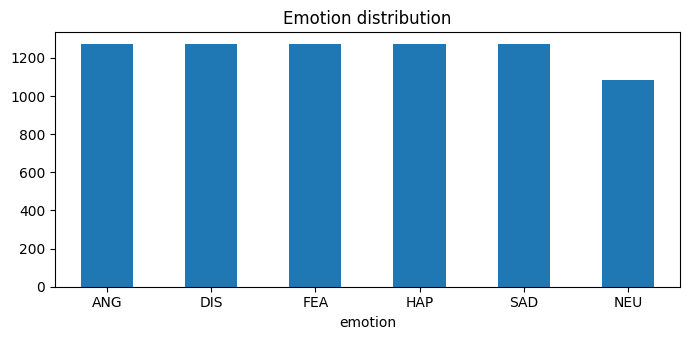

In [ ]:
import pandas as pd, matplotlib.pyplot as plt

df = pd.read_csv(f"{SPLIT_DIR}/metadata.csv")
print("Số diễn viên:", df['actor'].nunique())
print("\nPhân bố cảm xúc:\n", df['emotion'].value_counts())

plt.figure(figsize=(7,3.5))
df['emotion'].value_counts().plot(kind='bar', title='Emotion distribution')
plt.xticks(rotation=0); plt.tight_layout(); plt.show()



# **Tiền xử lý VIDEO → cache mặt**

In [32]:
import torch, cv2, numpy as np, os
from tqdm import tqdm
from facenet_pytorch import MTCNN
from pathlib import Path
import pandas as pd

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device)
mtcnn = MTCNN(image_size=224, margin=20, device=device, post_process=True, selection_method='probability')

def read_all_frames(video_path):
    cap = cv2.VideoCapture(video_path)
    frames=[]
    while True:
        ok, fr = cap.read()
        if not ok: break
        fr = cv2.cvtColor(fr, cv2.COLOR_BGR2RGB)
        frames.append(fr)
    cap.release()
    return frames

def uniform_sample(frames, T=16, jitter=True):
    if len(frames)==0:
        return []
    if len(frames) >= T:
        idx = np.linspace(0, len(frames)-1, num=T, dtype=int)
        if jitter and len(frames) > 2:
            idx = np.clip(idx + np.random.randint(-1,2,size=T), 0, len(frames)-1)
    else:
        idx = np.round(np.linspace(0, len(frames)-1, num=T)).astype(int)
    return [frames[i] for i in idx]

def crop_faces_tensor(frames):
    out=[]
    for f in frames:
        t = mtcnn(f)  # [3,224,224] or None
        if t is None:
            f2 = cv2.resize(f, (224,224))
            t = torch.from_numpy(f2.transpose(2,0,1)).float()/255.
        out.append(t.unsqueeze(0))
    return torch.cat(out, dim=0)  # [T,3,224,224]

CACHE_FACES = f"{CACHE_DIR}/faces"
os.makedirs(CACHE_FACES, exist_ok=True)

def preprocess_video_row(path, T=16):
    stem = Path(path).stem
    out_file = f"{CACHE_FACES}/{stem}_T{T}.pt"
    if os.path.exists(out_file):
        return out_file
    frames = read_all_frames(path)
    frames = uniform_sample(frames, T=T, jitter=True)
    if len(frames)==0:
        return None
    faces = crop_faces_tensor(frames)
    torch.save(faces, out_file)
    return out_file


Device: cuda


In [ ]:
paths = pd.read_csv(f"{SPLIT_DIR}/metadata.csv")['path'].tolist()
for p in tqdm(paths, desc="Preprocess VIDEO → faces"):
    preprocess_video_row(p, T=16)

print("✔️ Video preprocessing xong:", CACHE_FACES)


Kiểm tra 5 file cached ngẫu nhiên:

File: 1006_DFA_HAP_XX_T16.pt, Shape: torch.Size([16, 3, 224, 224])


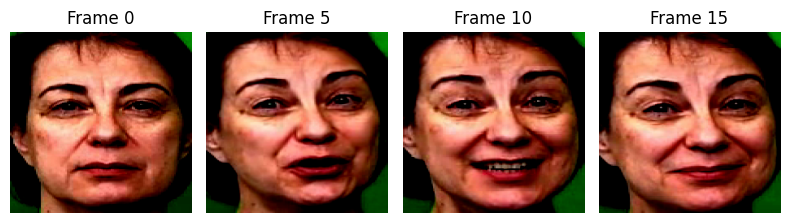


File: 1081_ITH_HAP_XX_T16.pt, Shape: torch.Size([16, 3, 224, 224])


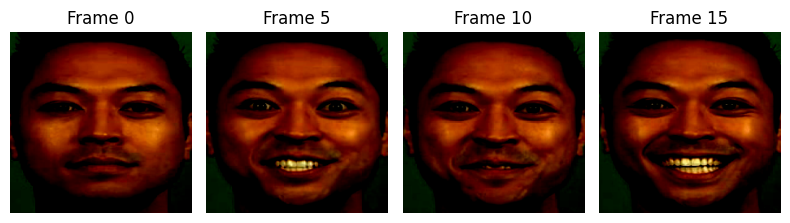


File: 1028_DFA_DIS_XX_T16.pt, Shape: torch.Size([16, 3, 224, 224])


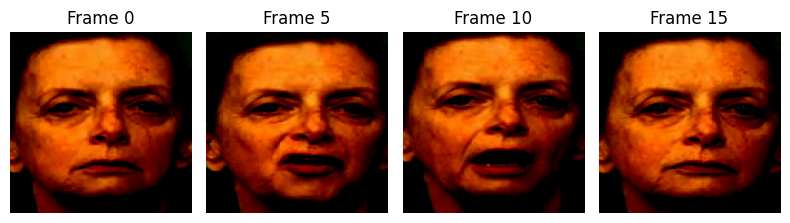


File: 1012_TSI_FEA_XX_T16.pt, Shape: torch.Size([16, 3, 224, 224])


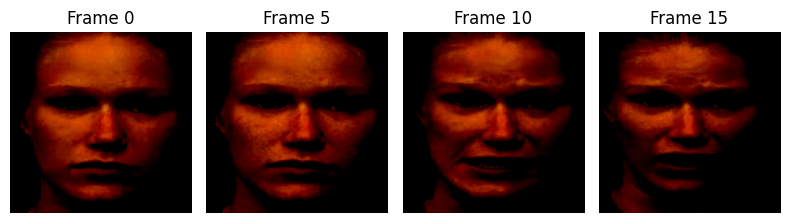


File: 1069_WSI_FEA_XX_T16.pt, Shape: torch.Size([16, 3, 224, 224])


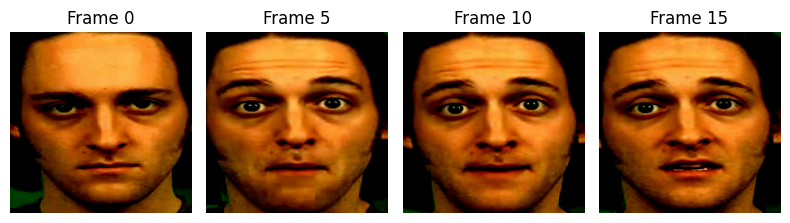

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import os

# Đường dẫn tới thư mục cache khuôn mặt
CACHE_FACES = "/content/drive/MyDrive/av_emotion/cache/faces"

# Lấy danh sách các file .pt trong thư mục
cached_files = [f for f in os.listdir(CACHE_FACES) if f.endswith('.pt')]

if not cached_files:
    print(f"Không tìm thấy file .pt nào trong thư mục: {CACHE_FACES}")
else:
    # Chọn ngẫu nhiên một vài file để kiểm tra
    num_to_check = min(5, len(cached_files))
    files_to_check = np.random.choice(cached_files, num_to_check, replace=False)

    print(f"Kiểm tra {num_to_check} file cached ngẫu nhiên:")

    # ImageNet normalize values (đảo ngược normalization)
    mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)

    for file_name in files_to_check:
        file_path = os.path.join(CACHE_FACES, file_name)
        try:
            # Load tensor
            faces_tensor = torch.load(file_path) # [T, 3, 224, 224] float 0..1 (sau tiền xử lý ban đầu)

            # Denormalize (nếu đã normalize trong Dataset, ở đây file .pt lưu 0..1)
            # faces_tensor = faces_tensor * std + mean # Chỉ cần nếu lưu normalize

            print(f"\nFile: {file_name}, Shape: {faces_tensor.shape}")

            # Chọn một vài khung hình để hiển thị
            num_frames_to_show = min(4, faces_tensor.shape[0])
            frame_indices = np.linspace(0, faces_tensor.shape[0] - 1, num_frames_to_show, dtype=int)

            plt.figure(figsize=(num_frames_to_show * 2, 2.5))
            for i, idx in enumerate(frame_indices):
                frame = faces_tensor[idx] # [3, 224, 224]
                # Chuyển từ [C, H, W] sang [H, W, C] cho matplotlib
                frame_np = frame.permute(1, 2, 0).numpy()

                # Đảm bảo giá trị pixel trong khoảng 0-1 (nếu tensor 0..1)
                # Nếu tensor đã normalize, cần denormalize trước khi clipping
                frame_np = np.clip(frame_np, 0, 1)


                plt.subplot(1, num_frames_to_show, i + 1)
                plt.imshow(frame_np)
                plt.title(f"Frame {idx}")
                plt.axis('off')
            plt.tight_layout()
            plt.show()

        except Exception as e:
            print(f"Lỗi khi đọc hoặc hiển thị file {file_name}: {e}")

# **Tiền xử lý AUDIO → wav16k → mel.pt**

In [33]:
# === AUDIO preprocess bằng torchaudio (không dính librosa/numba) ===
import os, subprocess, torch
from pathlib import Path
from tqdm import tqdm
import torchaudio
import pandas as pd

CACHE_WAV = f"{CACHE_DIR}/wav16k"
CACHE_MEL = f"{CACHE_DIR}/mels"
os.makedirs(CACHE_WAV, exist_ok=True)
os.makedirs(CACHE_MEL, exist_ok=True)

meta = pd.read_csv(f"{SPLIT_DIR}/metadata.csv")

def flv_to_wav16k(flv_path):
    stem = Path(flv_path).stem
    out = f"{CACHE_WAV}/{stem}.wav"
    if not os.path.exists(out):
        cmd = ["ffmpeg","-y","-v","error","-i", flv_path, "-ac","1","-ar","16000", out]
        subprocess.run(cmd, check=True)
    return out

SR = 16000
N_MELS = 80
HOP = int(SR * 10 / 1000)   # 10 ms
WIN = int(SR * 25 / 1000)   # 25 ms
mel_spec = torchaudio.transforms.MelSpectrogram(
    sample_rate=SR, n_fft=1024, hop_length=HOP, win_length=WIN,
    n_mels=N_MELS, power=2.0
)
amp_to_db = torchaudio.transforms.AmplitudeToDB(stype="power")

def wav_to_melpt_ta(wav_path):
    wav, sr = torchaudio.load(wav_path)      # [C, T]
    if sr != SR:
        wav = torchaudio.transforms.Resample(sr, SR)(wav)
    if wav.shape[0] > 1:
        wav = wav.mean(dim=0, keepdim=True)  # mono
    S = mel_spec(wav)                        # [1, n_mels, Tm]
    S_db = amp_to_db(S).squeeze(0).float()   # [n_mels, Tm]
    # chuẩn hóa theo sample
    S_db = (S_db - S_db.mean()) / (S_db.std() + 1e-6)
    out = f"{CACHE_MEL}/{Path(wav_path).stem}.pt"
    torch.save(S_db, out)
    return out


In [ ]:
err_cnt = 0
for p in tqdm(meta['path'].tolist(), desc="AUDIO preprocess"):
    try:
        wav = flv_to_wav16k(p)
        _ = wav_to_melpt_ta(wav)
    except Exception as e:
        err_cnt += 1
        print("Audio error:", p, e)

print(f"✔️ Audio preprocessing xong: {CACHE_WAV} và {CACHE_MEL} | lỗi: {err_cnt}")


In [2]:
# ===== Fixed length crop/pad theo thời gian =====
import torch
import torch.nn.functional as F
import numpy as np
import torch.nn as nn # Import torch.nn as nn

TARGET_T = 320  # ~3.2s @ 10ms hop

def crop_or_pad_mel(mel, target_T, mode="center"):
    # mel: [80, T]
    Tm = mel.shape[-1]
    if Tm == target_T:
        return mel
    if Tm > target_T:
        if mode == "random":
            s = np.random.randint(0, Tm - target_T + 1)
        else:  # center
            s = max((Tm - target_T) // 2, 0)
        return mel[:, s:s+target_T]
    else:
        pad_l = (target_T - Tm) // 2
        pad_r = target_T - Tm - pad_l
        return F.pad(mel, (pad_l, pad_r), value=0.0)  # sau CMVN mean≈0

# ===== SpecAugment đơn giản =====
class SpecAugment(nn.Module):
    def __init__(self, F=15, T=40, num_f=2, num_t=2, p=0.9):
        super().__init__()
        self.fm = torchaudio.transforms.FrequencyMasking(freq_mask_param=F)
        self.tm = torchaudio.transforms.TimeMasking(time_mask_param=T)
        self.num_f, self.num_t, self.p = num_f, num_t, p
    def forward(self, x):  # x: [1,80,T]
        if not self.training or np.random.rand() > self.p:
            return x
        for _ in range(self.num_f):
            x = self.fm(x)
        for _ in range(self.num_t):
            x = self.tm(x)
        return x

Kiểm tra 5 file Mel Spectrogram cached ngẫu nhiên:

File: 1026_ITH_ANG_XX.pt, Shape: torch.Size([80, 246])


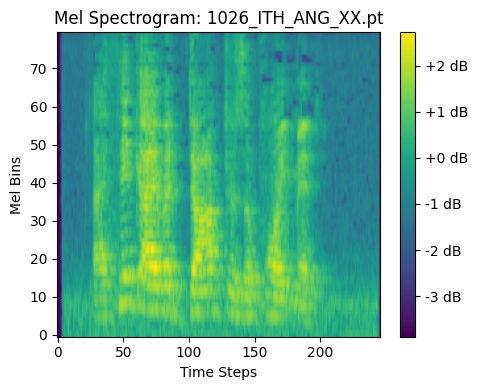


File: 1076_TSI_FEA_XX.pt, Shape: torch.Size([80, 199])


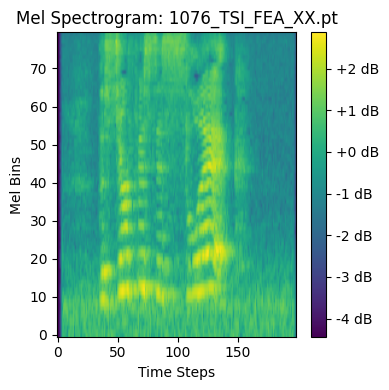


File: 1039_IEO_DIS_MD.pt, Shape: torch.Size([80, 262])


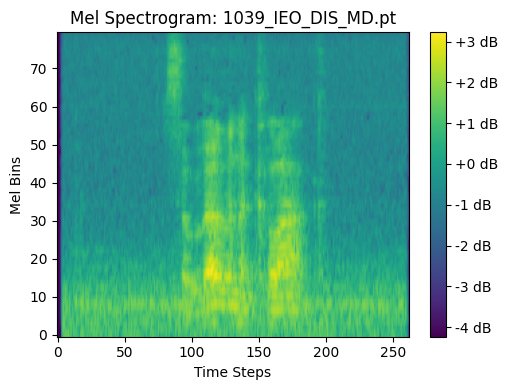


File: 1040_TSI_DIS_XX.pt, Shape: torch.Size([80, 290])


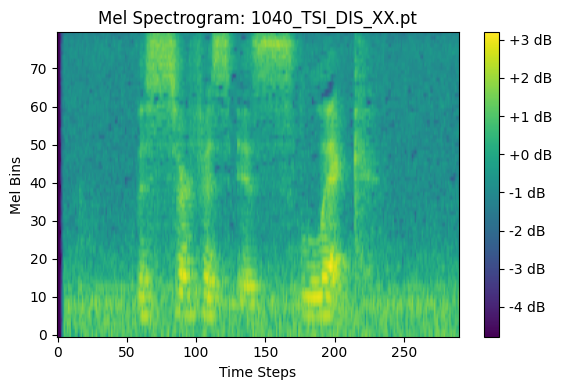


File: 1072_TIE_ANG_XX.pt, Shape: torch.Size([80, 348])


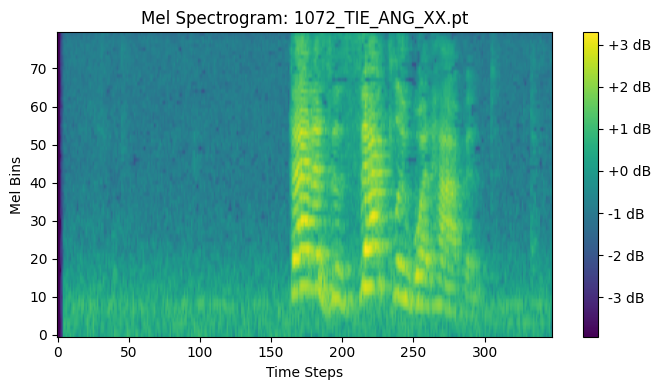

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import os

# Đường dẫn tới thư mục cache Mel Spectrograms
CACHE_MEL = "/content/drive/MyDrive/av_emotion/cache/mels"

# Lấy danh sách các file .pt trong thư mục
cached_mel_files = [f for f in os.listdir(CACHE_MEL) if f.endswith('.pt')]

if not cached_mel_files:
    print(f"Không tìm thấy file .pt nào trong thư mục: {CACHE_MEL}")
else:
    # Chọn ngẫu nhiên một vài file để kiểm tra
    num_to_check_mel = min(5, len(cached_mel_files))
    files_to_check_mel = np.random.choice(cached_mel_files, num_to_check_mel, replace=False)

    print(f"Kiểm tra {num_to_check_mel} file Mel Spectrogram cached ngẫu nhiên:")

    for file_name in files_to_check_mel:
        file_path = os.path.join(CACHE_MEL, file_name)
        try:
            # Load tensor
            mel_tensor = torch.load(file_path)  # [80, Tm]

            print(f"\nFile: {file_name}, Shape: {mel_tensor.shape}")

            plt.figure(figsize=(mel_tensor.shape[1] / 50, 4)) # Adjust figure size based on time steps
            # Convert to numpy and transpose for imshow (time on x-axis, mels on y-axis)
            mel_np = mel_tensor.numpy()
            plt.imshow(mel_np, aspect='auto', origin='lower', cmap='viridis') # origin='lower' đặt trục Y từ dưới lên
            plt.title(f"Mel Spectrogram: {file_name}")
            plt.xlabel("Time Steps")
            plt.ylabel("Mel Bins")
            plt.colorbar(format='%+2.0f dB') # Thêm color bar để hiểu giá trị màu
            plt.tight_layout()
            plt.show()

        except Exception as e:
            print(f"Lỗi khi đọc hoặc hiển thị file {file_name}: {e}")

# **Tạo split theo diễn viên (train/test/val)**

In [ ]:
# === Split theo actor, đảm bảo speaker-independent ===
import pandas as pd, numpy as np, json, os, random
from sklearn.model_selection import GroupShuffleSplit

meta = pd.read_csv(f"{SPLIT_DIR}/metadata.csv")  # bạn đã tạo ở bước tiền xử lý trước đó
assert 'actor' in meta.columns and 'emotion' in meta.columns and 'intensity' in meta.columns

gss = GroupShuffleSplit(n_splits=1, train_size=0.8, random_state=SEED)
tr_idx, te_idx = next(gss.split(meta, groups=meta['actor']))
train_val = meta.iloc[tr_idx].reset_index(drop=True)
test_df   = meta.iloc[te_idx].reset_index(drop=True)

gss2 = GroupShuffleSplit(n_splits=1, train_size=0.875, random_state=SEED)  # 0.8*0.875≈0.7
tr2_idx, va_idx = next(gss2.split(train_val, groups=train_val['actor']))
train_df = train_val.iloc[tr2_idx].reset_index(drop=True)
val_df   = train_val.iloc[va_idx].reset_index(drop=True)

train_df.to_csv(f"{SPLIT_DIR}/train.csv", index=False)
val_df.to_csv(f"{SPLIT_DIR}/val.csv",   index=False)
test_df.to_csv(f"{SPLIT_DIR}/test.csv", index=False)

print("Train/Val/Test:", len(train_df), len(val_df), len(test_df))
print("Actors:", train_df['actor'].nunique(), val_df['actor'].nunique(), test_df['actor'].nunique())

Train/Val/Test: 5153 737 1552
Actors: 63 9 19


# **Dataset & Dataloader (gọi lại cache faces/mels theo stem)**

In [3]:
import torch
from torch.utils.data import Dataset
import pandas as pd
from pathlib import Path
import os

class CremaDSplitDataset(Dataset):
    def __init__(self, csv_path, cache_faces, cache_mels,
                 target_mel_T=320, specaug=None):
        self.df = pd.read_csv(csv_path)
        self.cache_faces = cache_faces
        self.cache_mels = cache_mels
        self.target_mel_T = target_mel_T
        self.specaug = specaug

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        stem = Path(row["path"]).stem   # ví dụ: 1001_DFA_ANG_XX

        # --- video ---
        faces_file = os.path.join(self.cache_faces, f"{stem}_T16.pt")
        video = torch.load(faces_file)           # [T,3,224,224]
        video = video.float()

        # --- audio ---
        mel_file = os.path.join(self.cache_mels, f"{stem}.pt")
        mel = torch.load(mel_file)               # [80, Tm]
        mel = crop_or_pad_mel(mel, TARGET_T, mode="center")  # [80, TARGET_T]
        mel = mel.unsqueeze(0)                   # [1,80,T]

        if self.specaug is not None:
            mel = self.specaug(mel)

        label = int(row["emotion_id"])
        return video, mel, label, stem


In [4]:
from torch.utils.data import DataLoader
import torchaudio
CACHE_FACES = "/content/drive/MyDrive/av_emotion/cache/faces"
CACHE_MEL = "/content/drive/MyDrive/av_emotion/cache/mels"
def collate_fn(batch):
    videos  = torch.stack([b[0] for b in batch], dim=0)  # [B,T,3,224,224]
    audios  = torch.stack([b[1] for b in batch], dim=0)  # [B,1,80,Tm]
    labels  = torch.tensor([b[2] for b in batch], dtype=torch.long)
    stems   = [b[3] for b in batch]
    return videos, audios, labels, stems

train_ds = CremaDSplitDataset(
    f"{SPLIT_DIR}/train.csv",
    CACHE_FACES,
    CACHE_MEL,
    target_mel_T=TARGET_T,
    specaug=SpecAugment()
)
val_ds = CremaDSplitDataset(
    f"{SPLIT_DIR}/val.csv",
    CACHE_FACES,
    CACHE_MEL,
    target_mel_T=TARGET_T,
    specaug=None
)
test_ds = CremaDSplitDataset(
    f"{SPLIT_DIR}/test.csv",
    CACHE_FACES,
    CACHE_MEL,
    target_mel_T=TARGET_T,
    specaug=None
)

train_loader = DataLoader(train_ds, batch_size=16, shuffle=True,
                          num_workers=2, collate_fn=collate_fn)
val_loader   = DataLoader(val_ds, batch_size=16, shuffle=False,
                          num_workers=2, collate_fn=collate_fn)
test_loader  = DataLoader(test_ds, batch_size=16, shuffle=False,
                          num_workers=2, collate_fn=collate_fn)


In [5]:
import torch.nn as nn
import torchvision.models as models
import torch

class VideoEncoder(nn.Module):
    def __init__(self, out_dim=512, pretrained=True):
        super().__init__()
        base = models.resnet18(pretrained=pretrained)
        self.backbone = nn.Sequential(*list(base.children())[:-1])  # bỏ FC
        self.out_dim = out_dim

    def forward(self, x):
        # x: [B,T,3,224,224]
        B, T, C, H, W = x.shape
        x = x.view(B*T, C, H, W)
        feat = self.backbone(x)      # [B*T,512,1,1]
        feat = feat.view(B, T, self.out_dim)
        feat = feat.mean(dim=1)      # [B,512]
        return feat

class AudioEncoder(nn.Module):
    def __init__(self, out_dim=256):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(2),  # [1,80,T] -> [32,40,T/2]

            nn.Conv2d(32, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),  # [64,20,T/4]

            nn.Conv2d(64, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.AdaptiveAvgPool2d((1,1))  # [128,1,1]
        )
        self.fc = nn.Linear(128, out_dim)

    def forward(self, x):
        h = self.net(x)           # [B,128,1,1]
        h = h.view(h.size(0), -1) # [B,128]
        h = self.fc(h)            # [B,256]
        return h

class AVEmotionNet(nn.Module):
    def __init__(self, num_classes=6):
        super().__init__()
        self.video_enc = VideoEncoder()
        self.audio_enc = AudioEncoder()
        self.fusion = nn.Sequential(
              nn.Linear(512+256, 512),
              nn.ReLU(),
              nn.Dropout(0.5),
              nn.Linear(512, num_classes)
          )


    def forward(self, video, audio):
        v = self.video_enc(video)
        a = self.audio_enc(audio)
        x = torch.cat([v, a], dim=1)
        logits = self.fusion(x)
        return logits

In [ ]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

train_labels = pd.read_csv(f"{SPLIT_DIR}/train.csv")['emotion_id'].values
cls_weight = compute_class_weight(
    class_weight="balanced",
    classes=np.arange(len(EMO_ORDER)),
    y=train_labels
)
cls_weight = torch.tensor(cls_weight, dtype=torch.float).to(device)

In [ ]:
class EMA():
    """
    Exponential Moving Average (EMA) for model weights.
    """
    def __init__(self, model, decay):
        self.model = model
        self.decay = decay
        self.shadow = {}
        self.original = {}

        for name, param in model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()

    def update(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                new_average = (1.0 - self.decay) * param.data + self.decay * self.shadow[name]
                self.shadow[name] = new_average.clone()

    def apply_to(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                self.original[name] = param.data.clone()
                param.data.copy_(self.shadow[name])

    def restore(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                param.data.copy_(self.original[name])
        self.original = {}

## **Trainer với resume, AMP, best/last, CSV log, interrupt-safe**

In [ ]:
import os, time, torch, glob, csv, numpy as np
from sklearn.metrics import accuracy_score, f1_score
from torch.cuda.amp import GradScaler, autocast
from contextlib import nullcontext
import torch.nn as nn  # nếu bạn chưa import ở trên

def _append_csv(path, row, header):
    exists = os.path.exists(path)
    with open(path, "a", newline="") as f:
        writer = csv.writer(f)
        if not exists:
            writer.writerow(header)
        writer.writerow(row)

def train_mtl(model, train_loader, val_loader, device,
              lr=3e-4, epochs=30, save_dir=None,
              resume=True, resume_path=None, amp=True,
              keep_last_n=3, weight_decay=1e-4, csv_log_name="log.csv",
              show_progress=True, log_interval=50):

    os.makedirs(save_dir, exist_ok=True)
    csv_log = os.path.join(save_dir, csv_log_name)

    model = model.to(device)
    opt = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)
    scaler = GradScaler(enabled=(amp and torch.cuda.is_available()))
    ce_emo = nn.CrossEntropyLoss()

    # warmup + cosine
    def lr_lambda(ep):
        warm = 2
        if ep < warm:
            return (ep+1)/warm
        prog = (ep - warm) / max(1, (epochs - warm))
        return 0.5 * (1 + np.cos(np.pi * prog))
    sched = torch.optim.lr_scheduler.LambdaLR(opt, lr_lambda)

    # =========================
    # KHỞI TẠO
    # =========================
    best_f1 = -1.0        # sẽ được update từ best.pth (nếu có)
    start_epoch = 1

    if resume:
        # 1) ưu tiên đọc best.pth để lấy kỷ lục cũ
        best_path = os.path.join(save_dir, "best.pth")
        if os.path.exists(best_path):
            best_ckpt = torch.load(best_path, map_location=device, weights_only=False)
            best_f1 = float(best_ckpt.get("val_f1", -1.0))
            print(f"📦 Found best.pth with val_f1={best_f1:.3f}")

        # 2) sau đó mới đọc last.pth (hoặc resume_path) để biết đang ở epoch mấy
        ckpt_path = resume_path if (resume_path and os.path.exists(resume_path)) else os.path.join(save_dir, "last.pth")
        if os.path.exists(ckpt_path):
            ckpt = torch.load(ckpt_path, map_location=device, weights_only=False)
            model.load_state_dict(ckpt["model_state"], strict=True)
            if "optimizer_state" in ckpt:
                opt.load_state_dict(ckpt["optimizer_state"])
            if "scaler_state" in ckpt and ckpt["scaler_state"] is not None and amp:
                try:
                    scaler.load_state_dict(ckpt["scaler_state"])
                except:
                    print("⚠️ scaler_state không khớp, bỏ qua")
            start_epoch = int(ckpt.get("epoch", 0)) + 1
            print(f"🔁 Resume from {ckpt_path}, continue at epoch {start_epoch}")
        else:
            print("ℹ️ resume=True nhưng không tìm thấy last.pth, sẽ train từ đầu.")

    # =========================
    # VÒNG LẶP TRAIN
    # =========================
    for ep in range(start_epoch, epochs+1):
        t0 = time.time()
        # ===== TRAIN =====
        model.train()
        y_true, y_pred = [], []
        total_loss = 0.0

        for i, (videos, audios, labels, stems) in enumerate(train_loader):
            videos, audios, labels = videos.to(device), audios.to(device), labels.to(device)
            opt.zero_grad(set_to_none=True)
            ctx = autocast if (amp and torch.cuda.is_available()) else nullcontext
            with ctx():
                logits = model(videos, audios)
                loss = ce_emo(logits, labels)
            scaler.scale(loss).backward()
            scaler.step(opt)
            scaler.update()

            total_loss += loss.item() * labels.size(0)
            preds = logits.argmax(1)
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(preds.cpu().numpy())

            if show_progress and (i+1) % log_interval == 0:
                print(f"  [Train] Ep{ep} {i+1}/{len(train_loader)} loss={loss.item():.4f}")

        tr_loss = total_loss / len(train_loader.dataset)
        tr_acc = accuracy_score(y_true, y_pred)
        tr_f1  = f1_score(y_true, y_pred, average='macro')

        # ===== VAL =====
        model.eval()
        val_true, val_pred = [], []
        val_loss = 0.0
        with torch.no_grad():
            for videos, audios, labels, stems in val_loader:
                videos, audios, labels = videos.to(device), audios.to(device), labels.to(device)
                logits = model(videos, audios)
                loss = ce_emo(logits, labels)
                val_loss += loss.item() * labels.size(0)
                preds = logits.argmax(1)
                val_true.extend(labels.cpu().numpy())
                val_pred.extend(preds.cpu().numpy())
        val_loss /= len(val_loader.dataset)
        val_acc = accuracy_score(val_true, val_pred)
        val_f1  = f1_score(val_true, val_pred, average='macro')

        sched.step()

        print(f"[Ep {ep:03d}] Train L={tr_loss:.4f} A={tr_acc:.3f} F1={tr_f1:.3f} | "
              f"Val L={val_loss:.4f} A={val_acc:.3f} F1={val_f1:.3f} | {time.time()-t0:.1f}s")

        # ===== SAVE CKPT =====
        state = {
            "epoch": ep,
            "model_state": model.state_dict(),
            "optimizer_state": opt.state_dict(),
            "scaler_state": scaler.state_dict() if (amp and torch.cuda.is_available()) else None,
            "val_f1": val_f1,
        }
        # lưu từng epoch
        torch.save(state, os.path.join(save_dir, f"epoch_{ep:03d}.pth"))
        # lưu last
        torch.save(state, os.path.join(save_dir, "last.pth"))

        # lưu best đúng nghĩa
        if val_f1 > best_f1:
            best_f1 = val_f1
            torch.save(state, os.path.join(save_dir, "best.pth"))
            print(f"✅ New BEST F1={val_f1:.3f} at epoch {ep}")

        # dọn bớt ckpt
        if keep_last_n:
            ckpts = sorted(glob.glob(os.path.join(save_dir, "epoch_*.pth")))
            for p in ckpts[:-keep_last_n]:
                try:
                    os.remove(p)
                except:
                    pass

        _append_csv(os.path.join(save_dir, csv_log_name),
                    [ep, tr_loss, tr_acc, tr_f1, val_loss, val_acc, val_f1, round(time.time()-t0,3)],
                    ["epoch","train_loss","train_acc","train_f1","val_loss","val_acc","val_f1","seconds"])

    # cuối cùng load đúng best
    best_path = os.path.join(save_dir, "best.pth")
    if os.path.exists(best_path):
        ckpt = torch.load(best_path, map_location=device, weights_only=False)
        model.load_state_dict(ckpt["model_state"])
        print(f"🏁 Done. Loaded best.pth (F1={ckpt.get('val_f1',0):.3f})")

    return model, best_f1


## **Train Fusion Shared E-Branchformer MTL**

In [ ]:
model = AVEmotionNet(num_classes=6)

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 98.9MB/s]


In [ ]:
for p in model.video_enc.backbone.parameters():
    p.requires_grad = False

# (tùy chọn) In ra để kiểm tra
frozen_params = sum(p.numel() for p in model.parameters() if not p.requires_grad)
trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"🔒 Frozen: {frozen_params:,} params | 🧠 Trainable: {trainable_params:,} params")


🔒 Frozen: 11,176,512 params | 🧠 Trainable: 522,950 params


In [ ]:
# model = AVEmotionNet(num_classes=6)
model, best_f1 = train_mtl(
    model,
    train_loader,
    val_loader,
    device=device,
    save_dir=f"{OUTPUT_DIR}/av_ckpt",
    epochs=20,
    lr=1e-4,
    weight_decay=5e-4,
    resume=True
)


/tmp/ipython-input-1621204362.py:26: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler(enabled=(amp and torch.cuda.is_available()))


📦 Found best.pth with val_f1=0.707
🔁 Resume from /content/drive/MyDrive/av_emotion/outputs/av_ckpt/last.pth, continue at epoch 20


/tmp/ipython-input-1621204362.py:83: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with ctx():


  [Train] Ep20 50/323 loss=0.0293
  [Train] Ep20 100/323 loss=0.0268
  [Train] Ep20 150/323 loss=0.0087
  [Train] Ep20 200/323 loss=0.0214
  [Train] Ep20 250/323 loss=0.0017
  [Train] Ep20 300/323 loss=0.0013
[Ep 020] Train L=0.0321 A=0.990 F1=0.990 | Val L=1.8479 A=0.680 F1=0.680 | 4949.3s
🏁 Done. Loaded best.pth (F1=0.707)


In [ ]:
# Unfreeze backbone
for p in model.video_enc.backbone.parameters():
    p.requires_grad = True
frozen_params = sum(p.numel() for p in model.parameters() if not p.requires_grad)
trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"🔒 Frozen: {frozen_params:,} params | 🧠 Trainable: {trainable_params:,} params")



🔒 Frozen: 0 params | 🧠 Trainable: 11,699,462 params


In [ ]:

model, best_f1 = train_mtl(
    model,
    train_loader,
    val_loader,
    device=device,
    save_dir=f"{OUTPUT_DIR}/av_ckpt",
    epochs=30,          # fine-tune thêm
    lr=5e-5,            # LR nhỏ hơn để tránh phá đặc trưng video
    weight_decay=5e-4,
    resume=True
)

/tmp/ipython-input-1621204362.py:26: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler(enabled=(amp and torch.cuda.is_available()))


📦 Found best.pth with val_f1=0.707
🔁 Resume from /content/drive/MyDrive/av_emotion/outputs/av_ckpt/last.pth, continue at epoch 26


/tmp/ipython-input-1621204362.py:83: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with ctx():


  [Train] Ep26 50/323 loss=0.0003


# **Đánh giá trên tập test**

In [6]:
import torch
import os

# Define the path to the best model checkpoint
best_model_path = os.path.join(OUTPUT_DIR, "av_ckpt", "best.pth")

# Load the best model's state dictionary
if os.path.exists(best_model_path):
    print(f"Loading best model from: {best_model_path}")
    # Instantiate the model architecture first
    model = AVEmotionNet(num_classes=6) # Re-instantiate the model
    model.to(device)

    # Load the state dictionary, ensuring weights_only is False if metadata is needed
    # or setting map_location to device if the model was saved from a different device
    checkpoint = torch.load(best_model_path, map_location=device)
    model.load_state_dict(checkpoint['model_state'])
    model.eval() # Set the model to evaluation mode
    print(f"Model loaded successfully. Best F1 from checkpoint: {checkpoint.get('val_f1', 0):.3f}")
else:
    print(f"Error: Best model not found at {best_model_path}. Please ensure training was successful.")


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading best model from: /content/drive/MyDrive/av_emotion/outputs/av_ckpt/best.pth
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 219MB/s]


Model loaded successfully. Best F1 from checkpoint: 0.707


Evaluating the loaded model on the test set...

Classification Report:
              precision    recall  f1-score   support

         ANG       0.79      0.83      0.81       265
         DIS       0.75      0.75      0.75       265
         FEA       0.51      0.72      0.60       265
         HAP       0.95      0.88      0.91       265
         NEU       0.81      0.46      0.58       227
         SAD       0.55      0.56      0.56       265

    accuracy                           0.70      1552
   macro avg       0.73      0.70      0.70      1552
weighted avg       0.73      0.70      0.71      1552



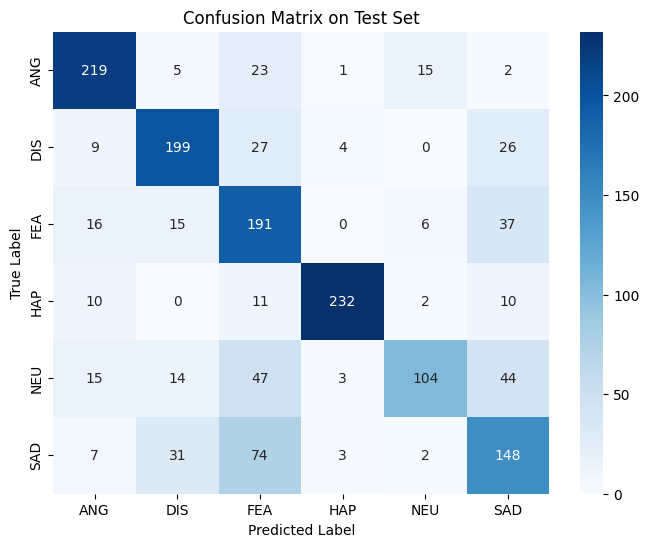

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

if 'model' in locals() and model.training == False: # Check if model is loaded and in eval mode
    print("Evaluating the loaded model on the test set...")
    all_true, all_pred = [], []
    with torch.no_grad():
        for videos, audios, labels, stems in test_loader:
            videos, audios, labels = videos.to(device), audios.to(device), labels.to(device)
            logits = model(videos, audios)
            preds = logits.argmax(1)
            all_true.extend(labels.cpu().numpy())
            all_pred.extend(preds.cpu().numpy())

    print("\nClassification Report:")
    print(classification_report(all_true, all_pred, target_names=EMO_ORDER))

    # Plot confusion matrix
    cm = confusion_matrix(all_true, all_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=EMO_ORDER, yticklabels=EMO_ORDER)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix on Test Set')
    plt.show()
else:
    print("Model not loaded or not in evaluation mode. Cannot perform evaluation.")


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

log_file_path = os.path.join(OUTPUT_DIR, "av_ckpt", "log.csv")

if os.path.exists(log_file_path):
    log_df = pd.read_csv(log_file_path)
    print(f"Successfully loaded log file from: {log_file_path}")
    display(log_df.head())
else:
    print(f"Error: log.csv not found at {log_file_path}.")
    log_df = None


Successfully loaded log file from: /content/drive/MyDrive/av_emotion/outputs/av_ckpt/log.csv


,epoch,train_loss,train_acc,train_f1,val_loss,val_acc,val_f1,seconds
0,1,0.947929,0.627790,0.624739,1.457467,0.500678,0.501367,5521.246
1,2,0.783072,0.702309,0.699475,1.107555,0.607870,0.605645,4567.351
2,3,0.631912,0.763633,0.762303,1.082727,0.651289,0.650130,4818.806
3,4,0.394967,0.858529,0.858325,1.251917,0.652646,0.655405,4768.716
4,5,0.343243,0.870561,0.870379,1.334499,0.624152,0.604494,4837.907


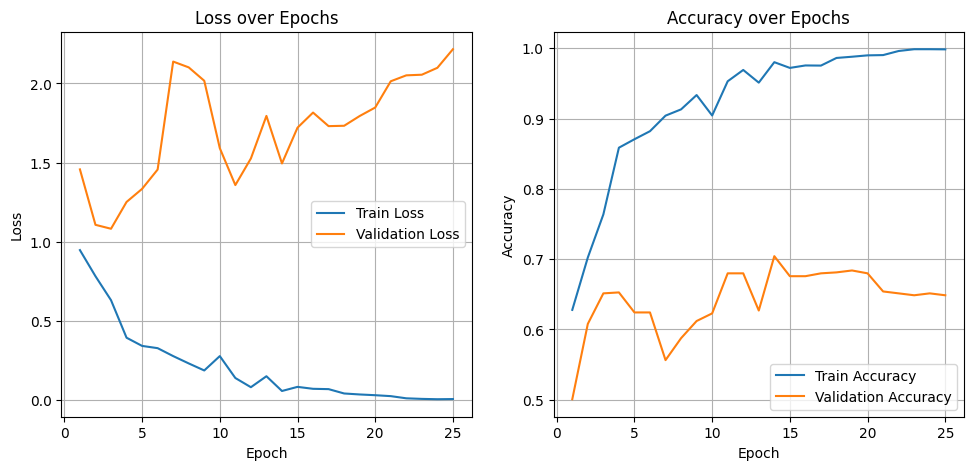

In [ ]:
if log_df is not None:
    plt.figure(figsize=(18, 5))

    # Plot Loss
    plt.subplot(1, 3, 1)
    sns.lineplot(data=log_df, x='epoch', y='train_loss', label='Train Loss')
    sns.lineplot(data=log_df, x='epoch', y='val_loss', label='Validation Loss')
    plt.title('Loss over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Plot Accuracy
    plt.subplot(1, 3, 2)
    sns.lineplot(data=log_df, x='epoch', y='train_acc', label='Train Accuracy')
    sns.lineplot(data=log_df, x='epoch', y='val_acc', label='Validation Accuracy')
    plt.title('Accuracy over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.grid(True)
    plt.legend()
else:
    print("Cannot plot metrics as log_df was not loaded.")


In [8]:
model.eval() # Set the model to evaluation mode

# Get a single sample batch from the test_loader
# The collate_fn returns: videos, audios, labels, stems
videos, audios, labels, stems = next(iter(test_loader))

# Move tensors to the appropriate device
videos = videos.to(device)
audios = audios.to(device)

print(f"Sample Batch - Videos shape: {videos.shape}, Audios shape: {audios.shape}")

# Perform inference without gradient calculation
with torch.no_grad():
    logits = model(videos, audios)

# Determine predicted class indices
predicted_classes = logits.argmax(1)

print(f"Predicted logits shape: {logits.shape}")
print(f"Predicted class indices: {predicted_classes}")
print(f"True class labels: {labels}")

Sample Batch - Videos shape: torch.Size([16, 16, 3, 224, 224]), Audios shape: torch.Size([16, 1, 80, 320]), Labels shape: torch.Size([16])
Predicted logits shape: torch.Size([16, 6])
Predicted class indices: tensor([0, 1, 2, 3, 0, 1, 0, 2, 0, 1, 1, 1, 2, 2, 2, 3], device='cuda:0')
True class labels: tensor([0, 1, 2, 3, 4, 5, 0, 0, 0, 1, 1, 1, 2, 2, 2, 3], device='cuda:0')


Displaying video frames and predictions for the first 3 samples:


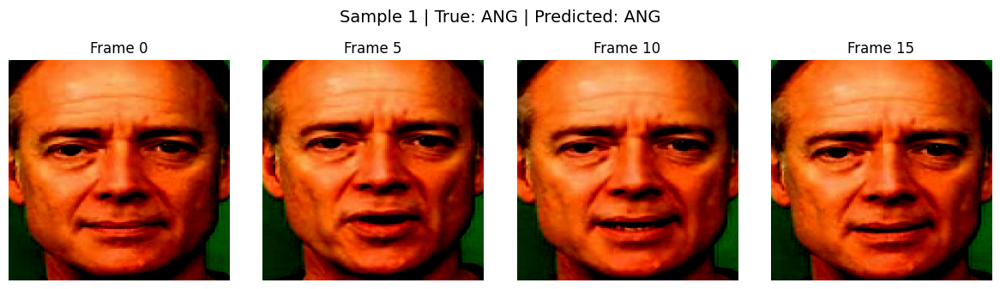

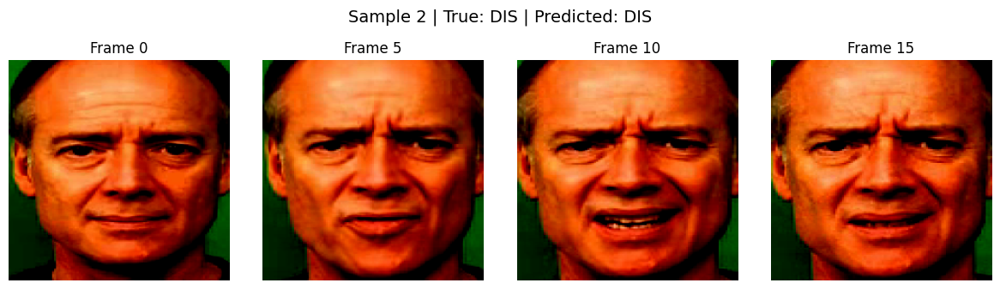

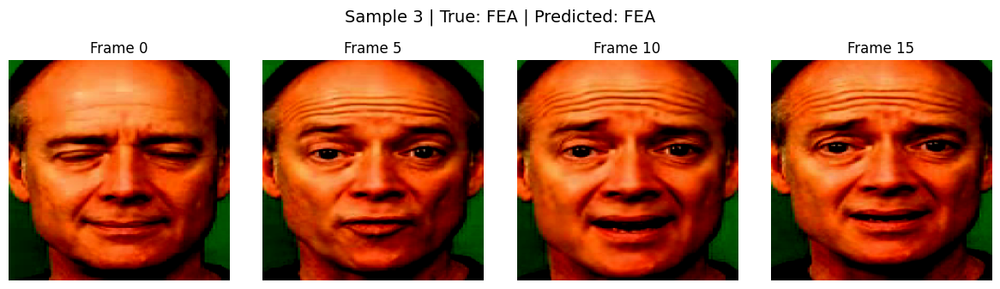

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


num_samples_to_display = min(4, videos.shape[2])

print(f"Displaying video frames and predictions for the first {num_samples_to_display} samples:")

for i in range(num_samples_to_display):
    sample_video = videos[i] # Shape: [T, 3, 224, 224]
    true_label_id = labels[i].item()
    predicted_label_id = predicted_classes[i].item()

    true_label_text = EMO_ORDER[true_label_id]
    predicted_label_text = EMO_ORDER[predicted_label_id]

    # Select a few frames to display (e.g., 4 frames spread across the video)
    num_frames_to_show = min(4, sample_video.shape[0])
    frame_indices = np.linspace(0, sample_video.shape[0] - 1, num_frames_to_show, dtype=int)

    plt.figure(figsize=(num_frames_to_show * 3, 3.5))
    plt.suptitle(f"Sample {i+1} | True: {true_label_text} | Predicted: {predicted_label_text}", fontsize=14)

    for j, frame_idx in enumerate(frame_indices):
        frame = sample_video[frame_idx] # Shape: [3, 224, 224]
        # Permute from [C, H, W] to [H, W, C] for matplotlib
        frame_cpu = frame.permute(1, 2, 0).cpu()
        frame_np = np.array(frame_cpu.tolist()) # Workaround: convert to list then to numpy

        # Denormalize if necessary (the cached faces are already 0-1, so clamping is sufficient)
        frame_np = np.clip(frame_np, 0, 1) # Ensure pixel values are in valid range for display

        plt.subplot(1, num_frames_to_show, j + 1)
        plt.imshow(frame_np)
        plt.title(f"Frame {frame_idx}")
        plt.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent suptitle overlap
    plt.show()

In [13]:
import os
from pathlib import Path
from IPython.display import Video, display

VIZ_DIR = "/content/tmp_viz"
os.makedirs(VIZ_DIR, exist_ok=True)

def convert_to_mp4_for_viz(video_path):
    """
    Convert bất kỳ video nào sang mp4 (H.264) để browser xem được.
    """
    video_path = str(video_path)
    stem = Path(video_path).stem
    out_mp4 = os.path.join(VIZ_DIR, stem + ".mp4")
    if not os.path.exists(out_mp4):
        # dùng ffmpeg convert
        !ffmpeg -y -v error -i "$video_path" -c:v libx264 -c:a aac "$out_mp4"
    return out_mp4


In [75]:
import pandas as pd
from pathlib import Path
from IPython.display import Video, display
import torch.nn.functional as F

EMO_MAP = {
    'ANGRY': 0,
    'DISGUST': 1,
    'FEAR': 2,
    'HAPPY': 3,
    'NEUTRAL': 4,
    'SAD': 5
}

# Map id -> code cảm xúc
ID2EMO = {v: k for k, v in EMO_MAP.items()}  # EMO_MAP bạn đã định nghĩa sẵn

def predict_cremad_clip(stem, set_name="test", show_video=True):
    """
    stem: tên file không đuôi, vd: '1001_DFA_ANG_XX'
    set_name: 'train' / 'val' / 'test'
    """
    # --- lấy info từ csv split ---
    csv_path = f"{SPLIT_DIR}/{set_name}.csv"
    df = pd.read_csv(csv_path)

    # tìm đúng dòng theo stem
    row = df[df["path"].str.contains(stem)].iloc[0]
    video_path = row["path"]
    gt_id  = int(row["emotion_id"])
    gt_emo = ID2EMO[gt_id]

    # --- load cache video & audio ---
    faces_file = os.path.join(CACHE_FACES, f"{stem}_T16.pt")
    mel_file   = os.path.join(CACHE_MEL, f"{stem}.pt")

    video = torch.load(faces_file).float()          # [T,3,224,224]
    video = video.unsqueeze(0).to(device)          # [1,T,3,224,224]

    mel = torch.load(mel_file).float()             # [80,Tm]
    mel = crop_or_pad_mel(mel, TARGET_T, "center") # [80,T]
    mel = mel.unsqueeze(0).unsqueeze(0).to(device) # [1,1,80,T]

    # --- forward model ---
    model.eval()
    with torch.no_grad():
        logits = model(video, mel)                 # [1,6]
        probs  = torch.softmax(logits, dim=1)[0]   # [6]
        pred_id = int(torch.argmax(probs).item())
        pred_emo = ID2EMO[pred_id]

    # --- in ra kết quả ---
    print(f"File     : {stem}")
    print(f"True emotion: {gt_emo} ({gt_id})")
    print(f"PRED emotion: {pred_emo} ({pred_id})")
    print("Probs:")
    for i in range(len(probs)):
        print(f"  {ID2EMO[i]}: {probs[i].item():.3f}")

    # --- hiển thị video ngay trong notebook ---
    if show_video:
        mp4_path = convert_to_mp4_for_viz(video_path)
        display(Video(mp4_path, embed=True, height=480))

    return {
        "stem": stem,
        "video_path": video_path,
        "gt_emo": gt_emo,
        "pred_emo": pred_emo,
        "probs": probs.cpu().numpy(),
    }


In [76]:
# ví dụ lấy 1 mẫu bất kỳ trong test set
test_meta = pd.read_csv(f"{SPLIT_DIR}/test.csv")
example_path = test_meta.iloc[30]["path"]
example_stem = Path(example_path).stem

res = predict_cremad_clip(example_stem, set_name="test", show_video=True)



File     : 1001_ITH_FEA_XX
True emotion: FEAR (2)
PRED emotion: FEAR (2)
Probs:
  ANGRY: 0.001
  DISGUST: 0.000
  FEAR: 0.999
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


In [64]:
from pathlib import Path
from IPython.display import Video, display

def preprocess_any_video(video_path, T=16):
    """
    Chạy full preprocess (face + mel) cho 1 video bất kỳ.
    Return: faces_file, mel_file, stem
    """
    video_path = str(video_path)
    stem = Path(video_path).stem

    # --- video -> faces ---
    faces_file = preprocess_video_row(video_path, T=T)   # đã định nghĩa phía trên
    if faces_file is None:
        raise ValueError("Không đọc được frame từ video!")

    # --- audio -> wav16k -> mel ---
    wav_path = flv_to_wav16k(video_path)   # tên hàm là flv nhưng ffmpeg xử lý được mp4, mov,...
    mel = wav_to_melpt_ta(wav_path)       # hàm này đang trả về path .pt
    mel_file = mel if isinstance(mel, str) else f"{CACHE_MEL}/{stem}.pt"

    return faces_file, mel_file, stem

def predict_any_video(video_path, true_label_code=None, show_video=True):
    """
    video_path: đường dẫn file video bất kỳ
    """
    faces_file, mel_file, stem = preprocess_any_video(video_path, T=16)

    video = torch.load(faces_file).float()          # [T,3,224,224]
    video = video.unsqueeze(0).to(device)          # [1,T,3,224,224]

    mel = torch.load(mel_file).float()             # [80,Tm]
    mel = crop_or_pad_mel(mel, TARGET_T, "center")
    mel = mel.unsqueeze(0).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        logits = model(video, mel)
        probs = torch.softmax(logits, dim=1)[0]
        pred_id = int(torch.argmax(probs).item())
        pred_emo = ID2EMO[pred_id]

    print(f"File       : {video_path}")
    if true_label_code is not None:
        print(f"True emotion : {true_label_code}")
    print(f"PRED emotion : {pred_emo}")
    print("Probs:")
    for i in range(len(probs)):
        print(f"  {ID2EMO[i]}: {probs[i].item():.3f}")

    if show_video:
        display(Video(video_path, embed=True, height=360))

    return {
        "stem": stem,
        "video_path": str(video_path),
        "gt_emo": true_label_code,
        "pred_emo": pred_emo,
        "probs": probs.cpu().numpy(),
    }


In [71]:
# Ví dụ video ngoài CREMA-D
path = "/content/HAPPY_VIDEO.mp4"

res = predict_any_video(path, true_label_code="HAPPY", show_video=True)


File       : /content/HAPPY_VIDEO.mp4
True emotion : HAPPY
PRED emotion : HAPPY
Probs:
  ANGRY: 0.382
  DISGUST: 0.003
  FEAR: 0.000
  HAPPY: 0.615
  NEUTRAL: 0.000
  SAD: 0.000


/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  def dispatcher(
/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/ffmpeg.py:88: UserWarning: torio.io._streaming_media_decoder.StreamingMediaDecoder has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be 

In [65]:
# Ví dụ video ngoài CREMA-D
path = "/content/ANGRY_VIDEO.mp4"

res = predict_any_video(path, true_label_code="ANGRY", show_video=True)


File       : /content/ANGRY_VIDEO.mp4
True emotion : ANGRY
PRED emotion : ANGRY
Probs:
  ANGRY: 1.000
  DISGUST: 0.000
  FEAR: 0.000
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


In [66]:
# Ví dụ video ngoài CREMA-D
path = "/content/DISGUST_VIDEO.mp4"

res = predict_any_video(path, true_label_code="DISGUST", show_video=True)


File       : /content/DISGUST_VIDEO.mp4
True emotion : DISGUST
PRED emotion : DISGUST
Probs:
  ANGRY: 0.067
  DISGUST: 0.933
  FEAR: 0.000
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


In [68]:
# Ví dụ video ngoài CREMA-D
path = "/content/FEAR_VIDEO.mp4"

res = predict_any_video(path, true_label_code="FEAR", show_video=True)


File       : /content/FEAR_VIDEO.mp4
True emotion : FEAR
PRED emotion : ANGRY
Probs:
  ANGRY: 0.983
  DISGUST: 0.001
  FEAR: 0.017
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


In [69]:
# Ví dụ video ngoài CREMA-D
path = "/content/SAD_VIDEO.mp4"

res = predict_any_video(path, true_label_code="SAD", show_video=True)


File       : /content/SAD_VIDEO.mp4
True emotion : SAD
PRED emotion : ANGRY
Probs:
  ANGRY: 1.000
  DISGUST: 0.000
  FEAR: 0.000
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  def dispatcher(
/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/ffmpeg.py:88: UserWarning: torio.io._streaming_media_decoder.StreamingMediaDecoder has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be 

In [70]:
# Ví dụ video ngoài CREMA-D
path = "/content/SUPPRISE_VIDEO.mp4"

res = predict_any_video(path, true_label_code="SUPPRISE", show_video=True)


File       : /content/SUPPRISE_VIDEO.mp4
True emotion : SUPPRISE
PRED emotion : ANGRY
Probs:
  ANGRY: 1.000
  DISGUST: 0.000
  FEAR: 0.000
  HAPPY: 0.000
  NEUTRAL: 0.000
  SAD: 0.000


/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  def dispatcher(
/usr/local/lib/python3.12/dist-packages/torchaudio/_backend/ffmpeg.py:88: UserWarning: torio.io._streaming_media_decoder.StreamingMediaDecoder has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be 

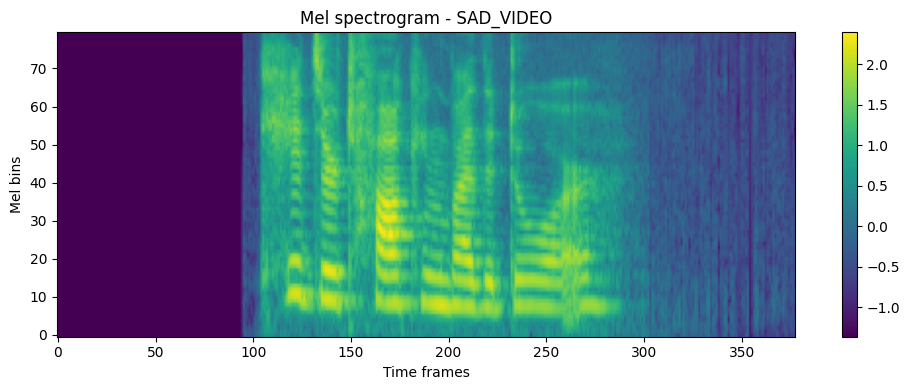

In [74]:
import matplotlib.pyplot as plt
faces_file, mel_file, stem = preprocess_any_video("/content/SAD_VIDEO.mp4", T=16)

mel = torch.load(mel_file)       # [80, T]
plt.figure(figsize=(10,4))
plt.imshow(mel.cpu().numpy(), origin="lower", aspect="auto")
plt.title(f"Mel spectrogram - {stem}")
plt.xlabel("Time frames"); plt.ylabel("Mel bins")
plt.colorbar(); plt.tight_layout(); plt.show()


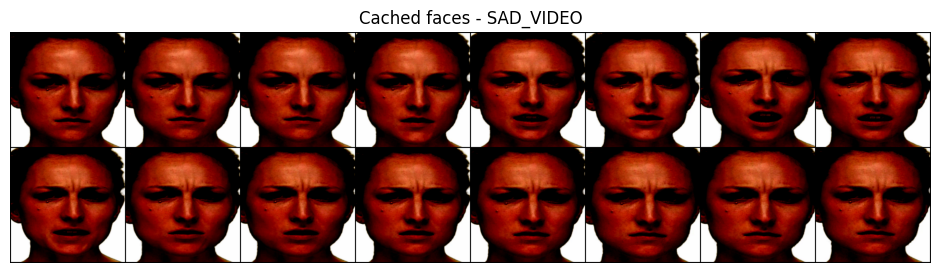

In [73]:
import torchvision.utils as vutils
faces_file, mel_file, stem = preprocess_any_video("/content/SAD_VIDEO.mp4", T=16)

faces = torch.load(faces_file).float()   # [T,3,224,224]
grid = vutils.make_grid(faces, nrow=8)
npimg = grid.permute(1,2,0).cpu().numpy()

plt.figure(figsize=(12,3))
plt.imshow(np.clip(npimg, 0, 1))
plt.axis("off")
plt.title(f"Cached faces - {stem}")
plt.show()
